## Notebook for computing Accessibility quantities of public transport networks in city (at the end a zip file is created for the citychrone web app)

* for the requirement check the requirements.txt file
* for the data:
    + download the GTFS data from [transitfeeds](https://transitfeeds.com/) or from ither openData resources.
    + download the shapefile data from [here](hhttp://www.oecd.org/cfe/regional-policy/functionalurbanareasbycountry.htm)
    + download the population data from [here](https://ghsl.jrc.ec.europa.eu/ghs_pop.php)

In [78]:
import sys
sys.path.insert(0, './src/')

In [79]:
import import_data

In [3]:
city = "Turin"  # name of the city
# urlMongoDb = "mongodb://localhost:27017/"; # url of the mongodb database
# client = pym.MongoClient(urlMongoDb)

# Download City Border

In [4]:
url_border = "http://www.oecd.org/cfe/regional-policy/functionalurbanareasbycountry.htm"
print("download shapefile of the city borders from:\n{0}".format(url_border))

download shapefile of the city borders from:
http://www.oecd.org/cfe/regional-policy/functionalurbanareasbycountry.htm


In [5]:
import shapefile
shape_ = shapefile.Reader("data/borders/italy/Italy.shp")
# first feature of the shapefile
records = shape_.records()
pos_city = 0
found = False
for n in range(len(records)):
    if city in records[n]:
        pos_city = n
        found = True
if not found:
    print("city not found!!")
geo_border = shape_.shapeRecords()[pos_city].shape.__geo_interface__
bbox = shape_.bbox
centroid = [(bbox[1] + bbox[3])/2, (bbox[0] + bbox[2])/2]

In [6]:
import folium
# Get the shape of the selected city
city_shape = shape_.shape(pos_city)

# Use the built-in functions to get the centroid of the city shape
centroid_geo = city_shape.points[0]

# Reverse the order of coordinates (longitude, latitude) -> (latitude, longitude)
centroid_geo = centroid_geo[::-1]

m = folium.Map(location=centroid_geo, zoom_start=9,
               prefer_canvas=True)  # Use centroid of geo_border
g = folium.GeoJson(city_shape.__geo_interface__).add_to(m)
bbox = g.get_bounds()
bb = folium.Rectangle(bbox).add_to(m)
m

## Make hexagonal grid

In [7]:
import hex_grid
from shapely.geometry import shape
import imp
imp.reload(hex_grid)
cell = 0.4
bbox_grid = [bbox[0][0], bbox[0][1], bbox[1][0], bbox[1][1]]
MultiPol, list_hexs = hex_grid.hexagonal_grid_border(
    shape(geo_border), cell, city)

/var/folders/jy/gjfds_4d4xsfqkq02klzlj240000gn/T/ipykernel_50164/1066267842.py:3: DeprecationWarning: the imp module is deprecated in favour of importlib and slated for removal in Python 3.12; see the module's documentation for alternative uses
  import imp


 99.4%, tot = 29565.0, inserted = 16460

In [8]:
import folium
m = folium.Map(location=centroid_geo, zoom_start=10, prefer_canvas=True)
for p in list_hexs:  # [0:200]:
    g = folium.GeoJson(p["hex"]).add_to(m)
m

## Fill with population

In [9]:
import pyproj
import numpy as np
import georaster

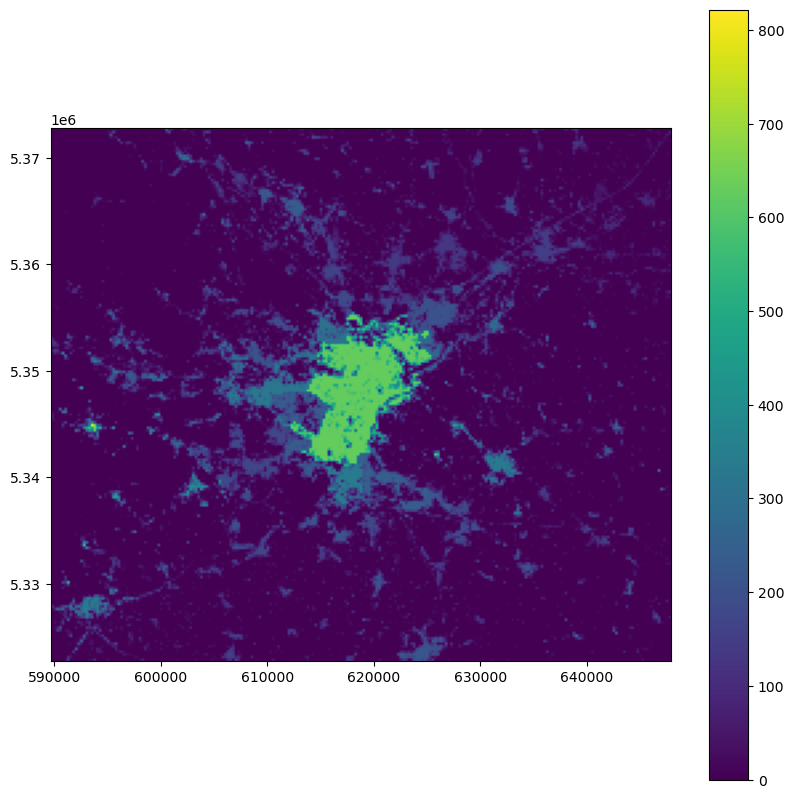

In [10]:
latll = bbox[0][0]
latur = bbox[1][0]
lonll = bbox[0][1]
lonur = bbox[1][1]

filepath = "./data/pop_data/GHS_POP_GPW42015_GLOBE_R2015A_54009_250_v1_0.tif"
my_image = georaster.SingleBandRaster(filepath,load_data=(lonll,lonur,latll,latur),latlon=True)
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize=(10,10))
plt.imshow(my_image.r,extent=my_image.extent)
plt.colorbar()
plt.show()

In [11]:
import georaster
tttt = 0
for i in range(len(list_hexs)):
    h_bound = shape(list_hexs[i]["hex"]).bounds
    latll = h_bound[1]
    latur = h_bound[3]
    lonll = h_bound[0]
    lonur = h_bound[2]

    my_image = georaster.SingleBandRaster(
        filepath, load_data=(lonll, lonur, latll, latur), latlon=True)
    tot = 0
    for r in range(len(my_image.r)):
        tot += sum(my_image.r[r])
    tttt += tot
    list_hexs[i]["pop"] = tot
    list_hexs[i]["num_p_pop"] = len(my_image.r)
    print(f"\r tot_pop: {tttt:.0f} i:{i}, pop: {tot:.0f}", end="")

 tot_pop: 2192552 i:16462, pop: 0189

In [12]:
from show_hexs import reduceGeojsonInShell
shell_list = np.arange(-1, 3000, 300)
[FeatureCollection, map_osm] = reduceGeojsonInShell(
    list_hexs, "pop", shell=shell_list)
map_osm

/Users/ocadni/git/public-transport-analysis/.conda/lib/python3.10/site-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


# Adding Stops

In [13]:
import pymongo as pym

urlMongoDb = "mongodb://localhost:27017/"  # url of the mongodb database

client = pym.MongoClient(urlMongoDb)
gtfsDB = client['PublicTransportAnalysis']

directoryGTFS = './data/pt/' + city + '/'  # directory of the gtfs files.

In [14]:
from read_conn import printGtfsDate
printGtfsDate(directoryGTFS)

interval of validity of the gtfs files
gtt_gtfs.zip file
 calendar.txt -> start_date:20231031, end_date:20231031 (first row)
gtt_gtfs.zip file
 calendar_dates.txt -> date:20231031 (first row)
smf.zip file
 calendar_dates.txt -> date:20141225 (first row)
smf.zip file
 calendar.txt -> start_date:20141214, end_date:20160612 (first row)


In [15]:
day = "20231108"  # hhhhmmdd
dayName = "wednesday"  # name of the corresponding day

In [16]:
from libStopsPoints import loadGtfsFile
listOfFile = ['stops.txt', 'routes.txt', 'trips.txt', 'calendar.txt',
              'calendar_dates.txt']  # , 'stop_times.txt']#, 'shapes.txt']
loadGtfsFile(gtfsDB, directoryGTFS, city, listOfFile)

removing stops  of  Turin
removing routes  of  Turin
removing trips  of  Turin
removing calendar  of  Turin
removing calendar_dates  of  Turin
gtt_gtfs.zip
stops.txt -> (7095,7095)
routes.txt -> (225,225)
trips.txt -> (77000,77000)
calendar.txt -> (1691,1691)
calendar_dates.txt -> (29952,29952)
smf.zip
stops.txt -> (132,7227)
routes.txt -> (15,240)
trips.txt -> (482,77482)
calendar.txt -> (16,1707)
calendar_dates.txt -> (333,30285)


In [17]:
from read_conn import readConnections
readConnections(gtfsDB, city, directoryGTFS, day, dayName)

number of file in calendar+calendar_dates: 2
in stops: 2

Checking the number of services active in the date selected:
file: gtt_gtfs.zip 	 total number of active service (in calendar.txt): 545
file: smf.zip 	 total number of active service (in calendar.txt): 12
number of different service_id: 2


file: gtt_gtfs.zip 	 total number of active service (in calendar_dates.txt): 1030
file: smf.zip 	 total number of active service (in calendar_dates.txt): 12
number of different service_id: 2 total number of active services found: 1042
number of trips 77000
 smf.zip
reading stop_times.txt...
readed... converting to a list
converted...
inserting to DB.... err 0, err_start 0, err_start_after 0_after 0
tot connections 4313

 gtt_gtfs.zip
reading stop_times.txt...
readed... converting to a list
converted...
inserting to DB....476, err 0, err_start 0, err_start_after 0tart_after 0
tot connections 404857


In [18]:
from libStopsPoints import removingStopsNoConnections, setPosField, removeStopsOutBorder
# removeStopsOutBorder(gtfsDB, city, 'OECD_city', ["commuting_zone", "city_core"])
removingStopsNoConnections(gtfsDB, city)
setPosField(gtfsDB, city)

In [19]:
from read_conn import updateConnectionsStopName
updateConnectionsStopName(gtfsDB, city)

connections deleted 09170 pEnd 409170, totC 409170


In [20]:
from libStopsPoints import returnStopsList
stopsList = returnStopsList(gtfsDB, city)

tot stop 7194  stop error : 0


In [21]:
stopDB = gtfsDB['stops'].find({'city': city}).sort([('_id', pym.ASCENDING)])

In [22]:
list_stops = []
for stop_i, stop in enumerate(stopDB):
    # print(stop)
    stop_temp = {"stop_I": stop["pos"],
                 "point": stop["point"],
                 "pos_only_stop": stop_i
                 }
    assert (stop_i == stop["pos"])
    list_stops.append(stop_temp)

# Make list of nodes (points + stops)

In [23]:
list_nodes = []
for point in list_hexs:
    pos = len(list_nodes)
    point_temp = point.copy()
    point_temp["pos"] = pos
    point_temp["type"] = "hex"
    list_nodes.append(point_temp)
for stop in list_stops:
    pos = len(list_nodes)
    stop_temp = stop.copy()
    stop_temp["pos"] = pos
    stop_temp["type"] = "stop"
    list_nodes.append(stop_temp)

In [24]:
print(len(list_nodes), len(list_hexs), len(list_stops))
len(list_hexs)+len(list_stops) == len(list_nodes)

23657 16463 7194


True

# Walking Path

In [25]:
import osmnx as ox
import networkx as nx
# download the street network
network_type = 'walk'
border_shapely = shape(geo_border)
G = ox.graph_from_polygon(border_shapely,
                          network_type=network_type,
                          simplify=True)

In [26]:
travel_speed = 5  # km/h walking speed
meters_per_minute = travel_speed * 1000 / 60  # km per hour to m per minute
for u, v, k, data in G.edges(data=True, keys=True):
    data['time'] = data['length'] / meters_per_minute

### Find the nearest node in the osm graph

In [27]:
def reset_neighbors(list_nodes):
    for pos, p in enumerate(list_nodes):
        list_nodes[pos]["node_n"] = []
        list_nodes[pos]["time_n"] = []
        list_nodes[pos]["node_n_osm"] = []
        list_nodes[pos]["node_n_stop"] = []
        list_nodes[pos]["time_n_stop"] = []
        list_nodes[pos]["node_n_osm_stop"] = []
        list_nodes[pos]["node_n_hex"] = []
        list_nodes[pos]["time_n_hex"] = []
        list_nodes[pos]["node_n_osm_hex"] = []

In [28]:
import walking_path
import importlib
importlib.reload(walking_path)

osm_node2pos = {}
count = 0
df_nearest = walking_path.compute_df_for_nearest_node(G)
dist_avg = 0
for pos, p in enumerate(list_nodes):
    # print(p)
    coor = list(reversed(p["point"]["coordinates"]))
    node, dist = walking_path.get_nearest_node(
        df_nearest, coor, return_dist=True)
    list_nodes[pos]["osm_node"] = node
    list_nodes[pos]["osm_node_dist"] = dist
    count += 1
    dist_avg += dist
    osm_node2pos[node] = pos
    print("\r{0} dist: {1:.2f} {2:.1f}".format(
        count, dist, dist_avg/count), end="")

23657 dist: 8.84 1912.782.8

### Adding walking path to neighbors node

In [29]:
count = 0
reset_neighbors(list_nodes)
limit_time_wp = 15  # min
time_average = 0
len_average = 0
count_add = 1
for pos, p in enumerate(list_nodes):
    source = p["osm_node"]
    nodes_times = nx.single_source_dijkstra_path_length(
        G, source, weight="time", cutoff=limit_time_wp)
    # print(nodes_times)
    count += 1
    len_average += len(nodes_times)
    for node_n in nodes_times:
        if node_n in osm_node2pos and node_n != source:
            tt = 60 * nodes_times[node_n]
            pos_n = osm_node2pos[node_n]
            list_nodes[pos]["node_n"].append(pos_n)
            list_nodes[pos]["time_n"].append(tt)
            list_nodes[pos]["node_n_osm"].append(node_n)
            time_average += tt
            count_add += 1
            if list_nodes[pos_n]["type"] == "stop":
                list_nodes[pos]["node_n_stop"].append(pos_n)
                list_nodes[pos]["time_n_stop"].append(tt)
                list_nodes[pos]["node_n_osm_stop"].append(node_n)
            else:
                list_nodes[pos]["node_n_hex"].append(pos_n)
                list_nodes[pos]["time_n_hex"].append(tt)
                list_nodes[pos]["node_n_osm_hex"].append(node_n)
                if list_nodes[pos_n]["type"] != "hex":
                    print("ERROR!!")

    print("\r{0} num_n: {1} avg_time {2:.1f}, avg_len {3:.1f}".format(count,
                                                                      len(list_nodes[pos]
                                                                          ["node_n"]),
                                                                      time_average/count_add,
                                                                      len_average/count_add), end="")

23657 num_n: 143 avg_time 595.0, avg_len 8.8

# Select the stops and hexs with almost one stops in the neighborhood

In [30]:
hex_with_stop = 0
stop_with_hex = 0
num_stop = 0
num_hex = 0
for hex_ in list_nodes:
    if hex_["type"] == "hex":
        num_hex += 1
        if len(hex_["node_n_stop"]) > 0:
            hex_with_stop += 1
    if hex_["type"] == "stop":
        num_stop += 1
        if len(hex_["node_n_hex"]) > 0:
            stop_with_hex += 1
print("number of hex with stops : {0} of {1}".format(hex_with_stop, num_hex))
print("number of stops with hex : {0} of {1}".format(stop_with_hex, num_stop))

number of hex with stops : 8163 of 16463
number of stops with hex : 7180 of 7194


In [31]:
list_stops = []
list_hexs = []
pos_hex = 0
pos_stop = 0
for node in list_nodes:
    if node["type"] == "hex" and len(node["node_n_stop"]) > 0:
        node["pos_hex"] = len(list_hexs)
        node_temp = node.copy()
        list_hexs.append(node_temp)
    if node["type"] == "stop":
        node["pos_stop"] = len(list_stops)
        node_temp = node.copy()
        list_stops.append(node_temp)

for hex_i, hex_ in enumerate(list_hexs):
    stopN_pos = []
    stopN_time = []
    for i_stop_n, stop_n in enumerate(hex_["node_n_stop"]):
        if (len(list_nodes[stop_n]["node_n_stop"]) > 0) or (len(list_nodes[stop_n]["node_n_hex"]) > 0):
            stopN_pos.append(list_nodes[stop_n]["pos_stop"])
            stopN_time.append(hex_["time_n_stop"][i_stop_n])
    hex_["stopN_pos"] = stopN_pos
    hex_["stopN_time"] = stopN_time
    hexN_pos = []
    hexN_time = []
    for i_hex_n, hex_n in enumerate(hex_["node_n_hex"]):
        if len(list_nodes[hex_n]["node_n_stop"]) > 0:
            hexN_pos.append(list_nodes[hex_n]["pos_hex"])
            hexN_time.append(hex_["time_n_hex"][i_hex_n])
    hex_["hexN_pos"] = hexN_pos
    hex_["hexN_time"] = hexN_time

# Create numpy tensor with neighbors for efficient computation

In [32]:
max_row_ss = 0
max_row_sh = 0
max_row_hs = 0
max_row_hh = 0
for stop in list_stops:
    stop["wp_ss_pos"] = []
    stop["wp_ss_time"] = []
    stop["wp_sh_pos"] = []
    stop["wp_sh_time"] = []
    for i_stop_n, stop_n in enumerate(stop["node_n_stop"]):
        stop["wp_ss_pos"].append(list_nodes[stop_n]["pos_stop"])
        stop["wp_ss_time"].append(stop["time_n_stop"][i_stop_n])

    for i_hex_n, hex_n in enumerate(stop["node_n_hex"]):
        if len(list_nodes[hex_n]["node_n_stop"]) > 0:
            stop["wp_sh_pos"].append(list_nodes[hex_n]["pos_hex"])
            stop["wp_sh_time"].append(stop["time_n_hex"][i_hex_n])
    max_row_ss = max(max_row_ss, len(stop["wp_ss_pos"]))
    max_row_sh = max(max_row_sh, len(stop["wp_sh_pos"]))
for h in list_hexs:
    h["wp_hh_pos"] = []
    h["wp_hh_time"] = []
    h["wp_hs_pos"] = []
    h["wp_hs_time"] = []
    for i_h_n, h_n in enumerate(h["node_n_hex"]):
        if len(list_nodes[h_n]["node_n_stop"]) > 0:
            h["wp_hh_pos"].append(list_nodes[h_n]["pos_hex"])
            h["wp_hh_time"].append(h["time_n_hex"][i_h_n])

    for i_stop_n, stop_n in enumerate(h["node_n_stop"]):
        h["wp_hs_pos"].append(list_nodes[stop_n]["pos_stop"])
        h["wp_hs_time"].append(h["time_n_stop"][i_stop_n])

    max_row_hh = max(max_row_hh, len(h["wp_hh_pos"]))
    max_row_hs = max(max_row_hs, len(h["wp_hs_pos"]))
print(max_row_ss, max_row_sh, max_row_hs, max_row_hh)
wp_ss_pos = np.full((len(list_stops), max_row_ss), -2)
wp_ss_time = np.full((len(list_stops), max_row_ss), -2)

wp_sh_pos = np.full((len(list_stops), max_row_sh), -2)
wp_sh_time = np.full((len(list_stops), max_row_sh), -2)

wp_hh_pos = np.full((len(list_hexs), max_row_hh), -2)
wp_hh_time = np.full((len(list_hexs), max_row_hh), -2)

wp_hs_pos = np.full((len(list_hexs), max_row_hs), -2)
wp_hs_time = np.full((len(list_hexs), max_row_hs), -2)

for i_stop, stop in enumerate(list_stops):
    for i_stop_n, stop_n in enumerate(stop["wp_ss_pos"]):
        wp_ss_pos[i_stop][i_stop_n] = stop["wp_ss_pos"][i_stop_n]
        wp_ss_time[i_stop][i_stop_n] = stop["wp_ss_time"][i_stop_n]

    for i_hex_n, hex_n in enumerate(stop["wp_sh_pos"]):
        wp_sh_pos[i_stop][i_hex_n] = stop["wp_sh_pos"][i_hex_n]
        wp_sh_time[i_stop][i_hex_n] = stop["wp_sh_time"][i_hex_n]

for i_h, h in enumerate(list_hexs):
    for i_h_n, h_n in enumerate(h["wp_hh_pos"]):
        wp_hh_pos[i_h][i_h_n] = h["wp_hh_pos"][i_h_n]
        wp_hh_time[i_h][i_h_n] = h["wp_hh_time"][i_h_n]

    for i_stop_n, stop_n in enumerate(h["wp_hs_pos"]):
        wp_hs_pos[i_h][i_stop_n] = h["wp_hs_pos"][i_stop_n]
        wp_hs_time[i_h][i_stop_n] = h["wp_hs_time"][i_stop_n]
wp = {
    "wp_ss_pos": wp_ss_pos,
    "wp_ss_time": wp_ss_time,
    "wp_sh_pos": wp_sh_pos,
    "wp_sh_time": wp_sh_time,
    "wp_hs_pos": wp_hs_pos,
    "wp_hs_time": wp_hs_time,
    "wp_hh_pos": wp_hh_pos,
    "wp_hh_time": wp_hh_time,
}

138 37 135 34


# Inserting the stops in the Database

In [33]:

removed = gtfsDB['stops'].delete_many({'city': city})
tot_stops_init = gtfsDB['stops'].count({'city': city})
list_stops_to_insert = []
for pos_stop, stop in enumerate(list_stops):
    # print(stop)
    listStopsN = []
    assert (pos_stop == stop["pos_stop"])
    # stop = list_stops[stop_db['pos']]
    for stop_n, time_stop in zip(stop['node_n_stop'], stop['time_n_stop']):
        listStopsN.append(
            {'pos': list_nodes[stop_n]["pos_stop"], 'time': time_stop})
    listPointN = []
    for point_n, time_point in zip(stop['node_n_hex'], stop['time_n_hex']):
        listPointN.append(
            {'pos': list_nodes[point_n]["pos_hex"], 'time': time_point})
    stop_temp = {}
    stop_temp['city'] = city
    stop_temp['pos'] = stop['pos_stop']
    stop_temp['point'] = stop['point']
    stop_temp['stopN'] = listStopsN
    stop_temp['pointN'] = listPointN
    stop_temp['stop_I'] = stop['stop_I']
    stop_temp['type'] = stop['type']
    stop_temp['point'] = stop['point']
    list_stops_to_insert.append(stop_temp)

gtfsDB['stops'].insert_many(list_stops_to_insert)

tot_stops = gtfsDB['stops'].count({'city': city})
print(f"number of stops: {tot_stops} init:{tot_stops_init}")

/var/folders/jy/gjfds_4d4xsfqkq02klzlj240000gn/T/ipykernel_50164/3207228859.py:2: DeprecationWarning: count is deprecated. Use estimated_document_count or count_documents instead. Please note that $where must be replaced by $expr, $near must be replaced by $geoWithin with $center, and $nearSphere must be replaced by $geoWithin with $centerSphere
  tot_stops_init = gtfsDB['stops'].count({'city': city})


number of stops: 7194 init:0


/var/folders/jy/gjfds_4d4xsfqkq02klzlj240000gn/T/ipykernel_50164/3207228859.py:29: DeprecationWarning: count is deprecated. Use estimated_document_count or count_documents instead. Please note that $where must be replaced by $expr, $near must be replaced by $geoWithin with $center, and $nearSphere must be replaced by $geoWithin with $centerSphere
  tot_stops = gtfsDB['stops'].count({'city': city})


# Adding connections

In [34]:
# [7,10,13,16,19,22] # List of starting time for computing the isochrones
timeList = list(range(6, 22, 2))
# timeList = [7,10,13,16,19,22] # List of starting time for computing the isochrones
hStart = timeList[0]*3600

In [35]:
import read_conn
conn_list = read_conn.makeArrayConnections(gtfsDB, hStart, city)

start making connections array
done recover all cc 409170
cenverted
Num of connection 409170


# Compute Isochrone

In [36]:
def hex_isochrone(start_hex, start_time, wp, conn_list):
    arrival_stops_times = np.full(len(list_stops), 100000000, dtype=np.int64)
    arrival_hexs_times = np.full(len(list_hexs), 100000000, dtype=np.int64)
    arrival_hexs_times[start_hex] = start_time
    wp_hh_pos = wp["wp_hh_pos"]
    wp_hh_time = wp["wp_hh_time"]
    wp_hs_pos = wp["wp_hs_pos"]
    wp_hs_time = wp["wp_hs_time"]
    hex_n = wp_hh_pos[start_hex]
    # loop in the hexs near to the selected hexs
    for n_i, n in enumerate(hex_n[hex_n != -2]):
        arrival_hexs_times[n] = wp_hh_time[start_hex][n_i] + start_time

    stops_n = wp_hs_pos[start_hex]
    for n_i, n in enumerate(stops_n[stops_n != -2]):
        # loop in the stops near to the selected hexs
        arrival_stops_times[n] = wp_hs_time[start_hex][n_i] + start_time

    arrival_stops_times = icsa.coreICSA(arrival_stops_times,
                                        conn_list,
                                        wp_ss_pos, wp_ss_time)
    arrival_hexs_times = icsa.computePointTime(arrival_hexs_times,
                                               arrival_stops_times,
                                               wp_hs_pos,
                                               wp_hs_time)

    arrival_hexs_times = arrival_hexs_times - start_time
    return arrival_hexs_times

In [37]:
import accessibilities
from area import area
start_time = 8*3600
delta_time = 2*3600  # maximum travel time considered for a trip 2h
conn_list_temp = [x for x in conn_list if x[0] < start_time + delta_time]
conn_list_temp = np.array(conn_list_temp)
sociality_func = accessibilities.ListFunctionAccessibility["socialityScore"]
velocity_func = accessibilities.ListFunctionAccessibility["velocityScore"]
array_pop = [x["pop"] for x in list_hexs]
area_hex = area(list_hexs[2]["hex"]) / (1000**2)

In [38]:
import time
import isochrone
import importlib
importlib.reload(isochrone)
tim = time.time()
list_hexs = isochrone.compute_all_isochrone(list_hexs,
                                            start_time, wp,
                                            conn_list_temp,
                                            array_pop, area_hex)

print(time.time() - tim)

17.181636810302734


In [39]:
shell = list(np.arange(-1, 15, 1))

color = ['#993404', "#f16913", "#fdae6b", '#74c476', '#31a354', '#006d2c', "#6baed6",
         "#4292c6", "#2171b5", '#08519c', '#f768a1', '#dd3497', '#ae017e', '#49006a']
shell = [0., 2., 4., 5, 6., 7, 8., 9, 10., 11, 12., 13, 15, 17.]

[FeatureCollection, map_osm] = reduceGeojsonInShell(list_hexs, "vel_score", shell=shell, color=color
                                                    )
map_osm

/Users/ocadni/git/public-transport-analysis/.conda/lib/python3.10/site-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [40]:
shell = list(np.arange(-1, 15, 1))

color = ["#000000", "rgb(95, 95, 95)", "rgb(180, 180, 180)", "rgb(8, 48, 107)", "rgb(15, 87, 159)", "rgb(47, 126, 188)", "rgb(109, 174, 213)", "rgb(181, 212, 233)", "rgb(253, 202, 148)",
         "rgb(253, 176, 122)", "rgb(250, 142, 93)", "rgb(241, 108, 73)", "rgb(224, 69, 48)", "rgb(243, 105, 163)", "rgb(224, 62, 152)", "rgb(153, 3, 124)", "rgb(73, 0, 106)"]
shell = [0, 50000, 100000, 200000, 300000, 400000, 500000, 600000,
         700000, 800000, 900000, 1000000, 1500000, 2000000, 2500000, 3000000]

[FeatureCollection, map_osm] = reduceGeojsonInShell(list_hexs, "soc_score", shell=shell, color=color
                                                    )
map_osm

# Adding Hex to the DB

In [41]:
removed = gtfsDB['points'].delete_many({'city': city})
tot_stops_init = gtfsDB['points'].count({'city': city})

list_hexs_to_insert = []
for hex_pos, hex_ in enumerate(list_hexs):
    # print(hex_)
    listStopsN = []
    print("\r{0} of {1}".format(hex_pos, hex_['pos']), end=" ")
    assert (hex_pos == hex_['pos_hex'])
    # print(hex_pos, hex_['node_n_stop'])
    assert (len(hex_['node_n_stop']) > 0)
    for stop_n, time_stop in zip(hex_['stopN_pos'], hex_['stopN_time']):
        listStopsN.append(
            {'pos': stop_n, 'time': time_stop})
    listPointN = []
    for hex_n, time_point in zip(hex_['hexN_pos'], hex_['hexN_time']):
        listPointN.append(
            {'pos': int(hex_n), 'time': time_point})
    list_hexs[hex_pos]['stopN'] = listStopsN
    list_hexs[hex_pos]['pointN'] = listPointN
    list_hexs[hex_pos]['pos'] = hex_pos
    hex_temp = {}
    hex_temp['city'] = city
    hex_temp['point'] = hex_['point']
    hex_temp['hex'] = hex_['hex']
    hex_temp['pos'] = hex_['pos_hex']
    # hex_temp['pos_hex'] = hex_['pos_hex']
    hex_temp['stopN'] = listStopsN
    hex_temp['pointN'] = listPointN
    hex_temp['pop'] = hex_['pop']
    hex_temp['type'] = hex_['type']
    hex_temp['soc_score'] = hex_['soc_score']
    hex_temp['vel_score'] = hex_['vel_score']
    # hex_temp['osm_node'] = hex_['osm_node']
    # hex_temp['vel_score'] = hex_['vel_score']
    # hex_temp['soc_score'] = hex_['soc_score']

    list_hexs_to_insert.append(hex_temp)

gtfsDB['points'].insert_many(list_hexs_to_insert)
gtfsDB['points'].create_index(
    [('city', pym.ASCENDING), ('pos', pym.ASCENDING)], unique=True)
tot_stops = gtfsDB['points'].count({'city': city})
print(f"number of hexs: {tot_stops} init:{tot_stops_init}")

/var/folders/jy/gjfds_4d4xsfqkq02klzlj240000gn/T/ipykernel_50164/455439973.py:2: DeprecationWarning: count is deprecated. Use estimated_document_count or count_documents instead. Please note that $where must be replaced by $expr, $near must be replaced by $geoWithin with $center, and $nearSphere must be replaced by $geoWithin with $centerSphere
  tot_stops_init = gtfsDB['points'].count({'city': city})


8162 of 16459 number of hexs: 8163 init:0


/var/folders/jy/gjfds_4d4xsfqkq02klzlj240000gn/T/ipykernel_50164/455439973.py:43: DeprecationWarning: count is deprecated. Use estimated_document_count or count_documents instead. Please note that $where must be replaced by $expr, $near must be replaced by $geoWithin with $center, and $nearSphere must be replaced by $geoWithin with $centerSphere
  tot_stops = gtfsDB['points'].count({'city': city})


# Save data

In [42]:
city_low = city.lower()

In [43]:
import os
import import_data

In [44]:
from save_data import makeZipCitychrone

city_path = "./data/saved/" + city_low + "/"
try:
    os.mkdir(city_path)
except:
    print("dir already Exists")

# If True in the citychrone platform tensting new scenario on the city is allowed.
newScenario = True

makeZipCitychrone(city, gtfsDB, arrayCC=conn_list,
                  newScenario=newScenario, path_main=city_path)

dir already Exists
len(P2SPos): 8163, len(P2STime): 8163, len(P2PPos): 8163, len(P2PTime): 8163


/Users/ocadni/git/public-transport-analysis/.conda/lib/python3.10/site-packages/shapely/ops.py:276: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  shell = type(geom.exterior)(zip(*func(*zip(*geom.exterior.coords))))


# [Optional] 
# Analisys on the accessibility quantities.

## Compute average time distance from the center
Computing the average time distance from the center of the city. 
We consider two center: 
1. where the velocityScore is max
2. Where the socialityScore is max.

In [46]:
from libStopsPoints import listPointsStopsN
arraySP = listPointsStopsN(gtfsDB, city)

In [52]:
from icsa_old import computeAccessibilities
import imp
import icsa_old
import libAccessibility
imp.reload(libAccessibility)
imp.reload(icsa)
imp.reload(icsa)
listAccessibility = ['velocityScore', 'socialityScore', 'velocityScoreGall',
                     'socialityScoreGall', 'velocityScore1h', 'socialityScore1h',
                     'timeVelocity', 'timeSociality']
computeIsochrone = False
if 'isochrones' in gtfsDB.collection_names():
    # gtfsDB['isochrones'].delete_many({'city':city})
    pass
timeList = [8]
for timeStart in timeList:
    timeStart *= 3600
    print('Time Isochrone Start: {0}'.format(timeStart/3600,))
    computeAccessibilities(city, timeStart, conn_list, arraySP, gtfsDB, computeIsochrone,
                           timeStart/3600 == timeList[0], listAccessibility=listAccessibility)

/Users/ocadni/git/public-transport-analysis/./src/libAccessibility.py:8: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @jit()
/Users/ocadni/git/public-transport-analysis/./src/libAccessibility.py:19: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @jit()
/Users/ocadni/git/public-transport-analysis/./src/libAccessibility.py:27: NumbaDeprecationWarning: The 'nopytho

Time Isochrone Start: 8.0


/Users/ocadni/git/public-transport-analysis/.conda/lib/python3.10/site-packages/pymongo/collection.py:1532: UserWarning: use an explicit session with no_cursor_timeout=True otherwise the cursor may still timeout after 30 minutes, for more info see https://docs.mongodb.com/v4.4/reference/method/cursor.noCursorTimeout/#session-idle-timeout-overrides-nocursortimeout
  return Cursor(self, *args, **kwargs)


## Compute averages of the accessiblity quantities computed

In [53]:
from libStopsPoints import computeAverage
computeAverage(listAccessibility, gtfsDB, city)

In [54]:
gtfsDB['points'].find_one({'city': city})["velocityScore"].keys()
timeListSec = []
for k in gtfsDB['points'].find_one({'city': city})["velocityScore"].keys():
    try:
        timeListSec.append(int(k))
    except:
        pass
if len(timeListSec) > 10:
    timeListSec = timeListSec[2:]
print(timeListSec)

[28800]


In [62]:
from libConnections import makeArrayConnections
from libStopsPoints import listPointsStopsN
from show_hexs import reduceGeojsonInShell
from icsa_old import coumputeAvgTimeDistance
from geopy.distance import great_circle
startPoint = gtfsDB['points'].find(
    {'city': city}, sort=[('velocityScore.avg', -1)])[0]

if 'arrayCC' not in locals():
    arrayCC = makeArrayConnections(gtfsDB, 0, city)
if 'arraySP' not in locals():
    arraySP = listPointsStopsN(gtfsDB, city)

timeDist = coumputeAvgTimeDistance(
    startPoint, timeListSec, arrayCC, arraySP, gtfsDB, city)
startPointLatLon = [startPoint['point']["coordinates"]
                    [1], startPoint['point']["coordinates"][0]]
for pos, tDist in enumerate(timeDist):
    pointSelectedLonLat = gtfsDB["points"].find_one({'pos': pos, "city": city})[
        "point"]["coordinates"]
    sVelDist = great_circle(
        startPointLatLon, (pointSelectedLonLat[1], pointSelectedLonLat[0])).meters  # dist in meter
    gtfsDB["points"].update_one({'pos': pos, 'city': city}, {
                                '$set': {'tVelDist': tDist, "sVelDist": sVelDist}})
print(timeDist)
pointsList = list(gtfsDB['points'].find(
    {'city': city}, {'pointN': 0, 'stopN': 0}))
res = reduceGeojsonInShell(pointsList, 'tVelDist')
res[1]

[66243. 66243. 66243. ... 44484. 44484. 44484.]


/Users/ocadni/git/public-transport-analysis/.conda/lib/python3.10/site-packages/folium/folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [63]:
startPoint = gtfsDB['points'].find(
    {'city': city}, sort=[('socialityScore.avg', -1)])[0]

if 'arrayCC' not in locals():
    arrayCC = makeArrayConnections(gtfsDB, 0, city)
if 'arraySP' not in locals():
    arraySP = listPointsStopsN(gtfsDB, city)

timeDist = coumputeAvgTimeDistance(
    startPoint, timeListSec, arrayCC, arraySP, gtfsDB, city)
for pos, tDist in enumerate(timeDist):
    gtfsDB["points"].update_one({'pos': pos, 'city': city}, {
                                '$set': {'tSocDist': tDist}})
timeDist
pointsList = list(gtfsDB['points'].find(
    {'city': city}, {'pointN': 0, 'stopN': 0}))
res = reduceGeojsonInShell(pointsList, 'tSocDist')
res[1]

## Analisys Exponential Decay of accessibility the quantities

### Velocity Score and Sociality score vs time distance from the center

 1. fitting function:
     $ae^{-bx}$
 2. fitting function:
     $ae^{-bx^2}$
 3. fitting function:
     $\text{maxValue} * e^{-bx^a}$

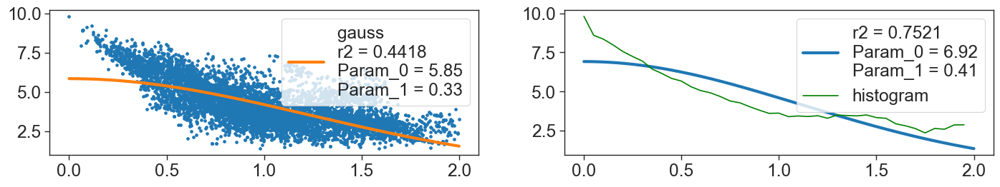

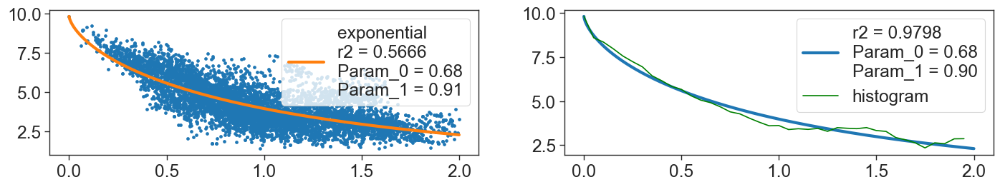

In [76]:
from libAnalysis import fitAndPlot, expon, gauss, giveVarExpon
import libAnalysis
imp.reload(libAnalysis)

maxValue = gtfsDB['points'].find({'city': city}, sort=[(
    ('velocityScore.avg', -1))])[0]["velocityScore"]["avg"]
functVarExp = giveVarExpon(maxValue)
# fitAndPlot('velocityScore','tVelDist', gtfsDB, city, expon, p0 = [12,0.0001], nameFunc = "exponential")
fitAndPlot('velocityScore', 'tVelDist', gtfsDB, city,
           gauss, p0=[12, 0.000001], nameFunc="gauss")
fitAndPlot('velocityScore', 'tVelDist', gtfsDB, city,
           functVarExp, p0=[1, 0.0001], nameFunc="exponential")

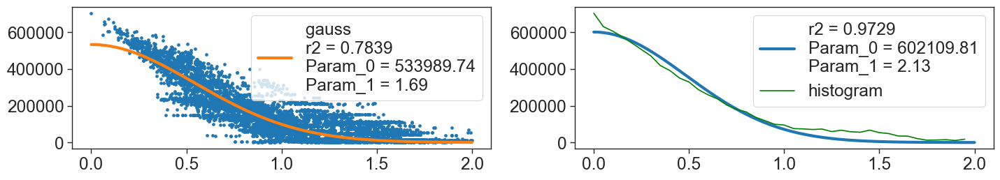

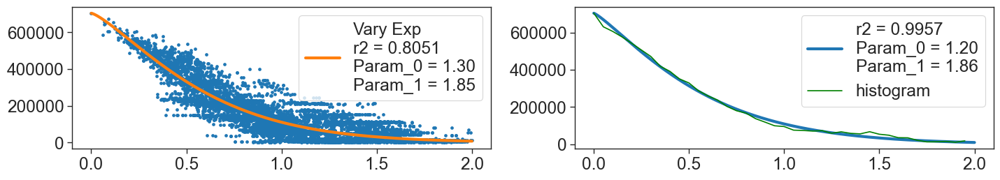

In [77]:
from libAnalysis import fitAndPlot, expon, gauss, giveVarExpon

quantity = "socialityScore"
distField = "tSocDist"
maxValue = gtfsDB['points'].find(
    {'city': city}, sort=[((quantity+'.avg', -1))])[0][quantity]["avg"]
functVarExp = giveVarExpon(maxValue)
# fitAndPlot(quantity,distField, gtfsDB, city, expon, p0 = [100000,0.0001], nameFunc = "exponential")
fitAndPlot(quantity, distField, gtfsDB, city, gauss,
           p0=[100000, 0.0000001], nameFunc="gauss")
fitAndPlot(quantity, distField, gtfsDB, city, functVarExp,
           p0=[1, 0.001], nameFunc="Vary Exp")